# **YOLO OBJECT DETECTION ASSESSMENT**

Tasks :
- The dataset given consists of images of `live` and `spoof` data.
- You may use any open-source YOLO repositories to complete this assessment.
- Please try to complete section by section.
- There are 2 types of assessment to be completed:
  - Code
  - Explanation  

Note:
- This assessment should be completed in **_3 days_**. Please manage your time accordingly.
- Ensure that **ALL** code blocks has been executed, including training, evaluation, benchmark and visualizations upon submission.
- Add comments to your codes. 


Reference :
- https://pyimagesearch.com/2022/06/20/training-the-yolov5-object-detector-on-a-custom-dataset/
- https://github.com/ultralytics/ultralytics


7 sections to be completed :
- A) PREPROCESSING
- B) VISUALIZE PREPROCESSED DATA
- C) TRAINING
- D) FINDINGS AND CONCLUSION
- E) EVALUATE ON TEST SETS
- F) SUMMARIZE AND IMPROVEMENTS
- G) BONUS POINTS

## A) PREPROCESSING
- Dataset Distribution:
  - Train: 120
  - Validation: 20
  - Test: 20
<!-- you are given datasets : 120 for train , 20 for val , 20 for test -->
- Annotation text file is given in the following format:
  - class_index, x-center, y-center, w , h

Task(s):
- Resize image size
- Recalculate resized images' coordinates:
  - x-center_resized, y-center_resized, w_resized , h_resized
- All the results should be in thier respective folder(s):
    - images/train , images/val, image/test
    - labels/train , labels/val, labels/test
    - *HINT: different YOLO versions/ repositories may have different directory format*

In [9]:
# To Convert Labels to YOLO Format

import os
import cv2
import glob

# Base directory
base_path = 'datasets'

output_base_path = "processed_datasets"

# List of splits to convert
splits = ['train', 'val', 'test']

for split in splits:
    print(f"Processing split: {split}")

    image_dir = os.path.join(base_path, 'images', split)
    label_dir = os.path.join(base_path, 'labels', split)

    # Output normalized labels directory
    output_label_dir = os.path.join(output_base_path, split, 'labels')
    os.makedirs(output_label_dir, exist_ok=True)

    # Get all image paths
    image_paths = glob.glob(os.path.join(image_dir, '*'))

    for image_path in image_paths:
        img = cv2.imread(image_path)
        if img is None:
            continue

        height, width, _ = img.shape

        filename = os.path.basename(image_path)
        name, _ = os.path.splitext(filename)
        label_path = os.path.join(label_dir, name + '.txt')

        if not os.path.exists(label_path):
            continue

        with open(label_path, 'r') as f:
            lines = f.readlines()

        yolo_lines = []
        for line in lines:
            parts = line.strip().split()
            if len(parts) != 5:
                continue  # Skip malformed lines

            cls, x_center_px, y_center_px, w_px, h_px = map(float, parts)

            # Normalize values
            x_center = x_center_px / width
            y_center = y_center_px / height
            w = w_px / width
            h = h_px / height

            yolo_lines.append(f"{int(cls)} {x_center:.6f} {y_center:.6f} {w:.6f} {h:.6f}\n")

        # Save normalized label
        output_path = os.path.join(output_label_dir, name + '.txt')
        with open(output_path, 'w') as f:
            f.writelines(yolo_lines)

        print(f"Converted: {label_path} -> {output_path}")


Processing split: train
Converted: datasets\labels\train\494420.txt -> processed_datasets\train\labels\494420.txt
Converted: datasets\labels\train\494437.txt -> processed_datasets\train\labels\494437.txt
Converted: datasets\labels\train\494457.txt -> processed_datasets\train\labels\494457.txt
Converted: datasets\labels\train\494466.txt -> processed_datasets\train\labels\494466.txt
Converted: datasets\labels\train\494473.txt -> processed_datasets\train\labels\494473.txt
Converted: datasets\labels\train\494474.txt -> processed_datasets\train\labels\494474.txt
Converted: datasets\labels\train\494534.txt -> processed_datasets\train\labels\494534.txt
Converted: datasets\labels\train\494536.txt -> processed_datasets\train\labels\494536.txt
Converted: datasets\labels\train\494539.txt -> processed_datasets\train\labels\494539.txt
Converted: datasets\labels\train\494580.txt -> processed_datasets\train\labels\494580.txt
Converted: datasets\labels\train\494683.txt -> processed_datasets\train\labe

In [10]:
import os
from PIL import Image

# Base folder path
base_path = 'datasets'
output_base_path = 'processed_datasets'
target_size = (640, 640)

# For train/val/test sets
splits = ['train', 'val', 'test']

for split in splits:
    image_dir = os.path.join(base_path, 'images', split)

    for filename in os.listdir(image_dir):
        if not filename.lower().endswith(('.jpg', '.jpeg', '.png')):
            continue

        # Load image
        image_path = os.path.join(image_dir, filename)
        image = Image.open(image_path)
        w_orig, h_orig = image.size

        # Resize and overwrite image
        image_resized = image.resize(target_size)
        
        output_image_path = os.path.join(output_base_path, split, 'images', filename)
        os.makedirs(os.path.dirname(output_image_path), exist_ok=True)
        
        image_resized.save(output_image_path)

       


## B) VISUALIZE PREPROCESSED DATA
- draw bounding box on any 10 images from task A to verify processed datasets and coordinates

In [8]:
import os
import cv2
import glob

# Set base path
base_path = 'processed_datasets'
split = 'train'  # Change to 'val' or 'test' to check others


image_dir = os.path.join(base_path, 'images', split)
label_dir = os.path.join(base_path, 'labels', split)

# List of image files
image_paths = glob.glob(os.path.join(image_dir, '*'))

for image_path in image_paths:
    img = cv2.imread(image_path)
    if img is None:
        continue
    print(f"Image: {image_path}")
    height, width, _ = img.shape

    # Get matching label path
    filename = os.path.basename(image_path)
    name, _ = os.path.splitext(filename)
    label_path = os.path.join(label_dir, name + '.txt')
    print(f"Label: {label_path}")
    if not os.path.exists(label_path):
        continue

    # Read YOLO labels
    with open(label_path, 'r') as f:
        lines = f.readlines()

    for line in lines:
        print(f"Raw label: {line.strip()}")
        cls, x_center, y_center, w, h = map(float, line.strip().split())

        # Convert normalized coords to absolute pixel values
        x_center *= width
        y_center *= height
        w *= width
        h *= height

        x1 = int(x_center - w / 2)
        y1 = int(y_center - h / 2)
        x2 = int(x_center + w / 2)
        y2 = int(y_center + h / 2)

        print(f"Drawing box: ({x1}, {y1}) to ({x2}, {y2})")

        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(img, str(int(cls)), (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

    # Show image
    cv2.imshow('YOLO Label Visualization', img)
    key = cv2.waitKey(0)
    if key == 27:  # ESC to exit early
        break

cv2.destroyAllWindows()


Image: processed_datasets\images\train\494420.png
Label: processed_datasets\labels\train\494420.txt
Raw label: 1 0.402083 0.595313 0.316667 0.378125
Drawing box: (155, 260) to (358, 502)
Image: processed_datasets\images\train\494437.png
Label: processed_datasets\labels\train\494437.txt
Raw label: 0 0.430645 0.160167 0.147312 0.160167
Drawing box: (228, 51) to (322, 153)
Image: processed_datasets\images\train\494457.png
Label: processed_datasets\labels\train\494457.txt
Raw label: 1 0.477083 0.470313 0.516667 0.646875
Drawing box: (139, 94) to (470, 508)
Image: processed_datasets\images\train\494466.png
Label: processed_datasets\labels\train\494466.txt
Raw label: 1 0.553125 0.482812 0.910417 1.159375
Drawing box: (62, -62) to (645, 679)
Image: processed_datasets\images\train\494473.png
Label: processed_datasets\labels\train\494473.txt
Raw label: 0 0.473047 0.302734 0.196094 0.302734
Drawing box: (240, 96) to (365, 290)
Image: processed_datasets\images\train\494474.png
Label: processed_da

## C) TRAINING

- Please include your training parameters. (screenshot/ in written form)
<!-- pls include your configuration written here all screenshot of your parameters setup and etc -->
- Specify your output directory path.
  - Model
  - Plots
  - Images (if you have any)

*Hints : according to yolo, you need to have the following files:*
  - hyp yaml file
  - dataset yaml file
  - model yaml file

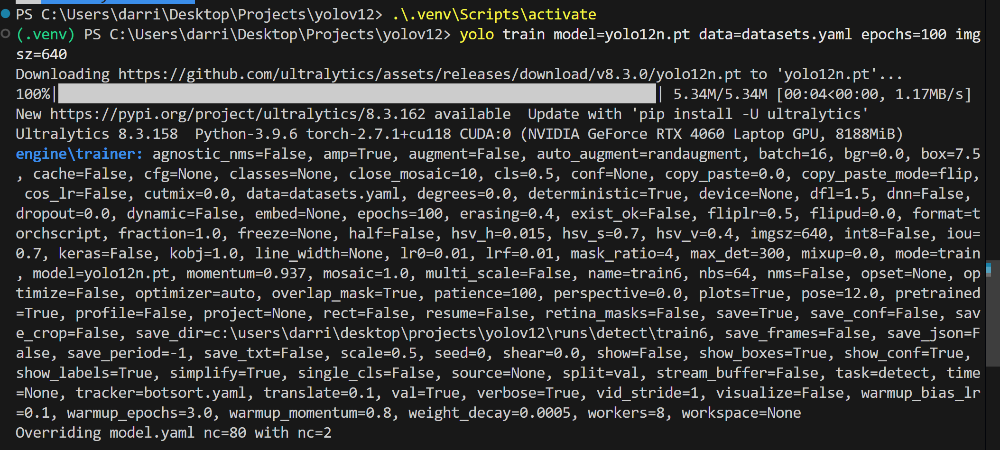

In [ ]:
# yolo train model=yolo12n.pt data=datasets.yaml epochs=100 imgsz=640


## D) FINDINGS
- Please state your findings on:
  - Benchmark
  - Performance
  - Visualization

### 1. Confusion Matrix

In [ ]:
'''
Observations:
Real Faces (actual):
- Correctly predicted as real_face: 10
- Misclassified as photo_face: 1

Photo Faces (actual):
- Correctly predicted as photo_face: 2
- Misclassified as real_face: 9

Background:
- Never appeared in either true or predicted data

Implications:
- The model frequently confuses photo_face with real_face. It predicted "real_face" for 9 out of 11 actual "photo_face" instances — this is a false negative for photo_face
- "real_face" predictions are more accurate, but not perfect (1 misclassified)

'''

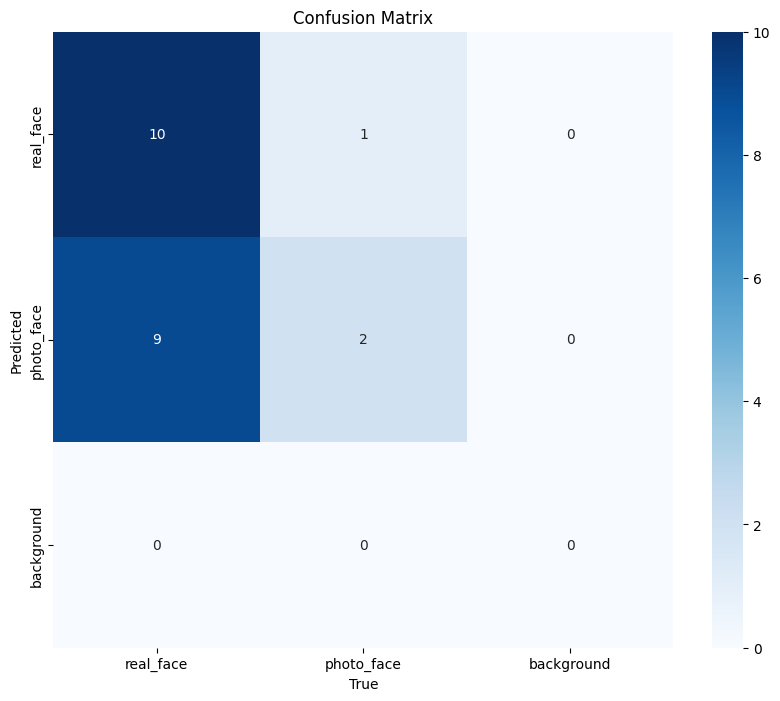

In [1]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix

# Ground truth labels
y_true = ['real_face'] * 11 + ['photo_face'] * 11
# Model predictions
y_pred = ['real_face'] * 10 + ['photo_face'] + ['real_face'] * 9 + ['photo_face'] * 2

# Class names
labels = ['real_face', 'photo_face', 'background']

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred, labels=labels)

# Plot
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, cmap='Blues', xticklabels=labels, yticklabels=labels, fmt='g')
plt.xlabel("True")
plt.ylabel("Predicted")
plt.title("Confusion Matrix")
plt.show()


### 2. Overall Training Results

In [ ]:
'''
1. Loss Over Epochs
Training Losses:
- All training losses (box, class, DFL) decrease steadily, showing effective learning.
- Box and class loss drop below 0.5, while DFL (Distribution Focal Loss) stabilizes around 1.0.

Validation Losses:
- Initially noisy but trend downward and stabilize similarly to training losses.
- No major divergence from training loss, indicating no overfitting.

Interpretation: 
- The loss curves are healthy, consistent downward trend and convergence by ~epoch 70. 
- Model generalizes well to validation data.

-------------------------------------------------------

2. Detection Metrics Over Epochs
Precision (Blue line):
- Starts low but improves significantly after ~20 epochs.
- Stabilizes above 0.9 after epoch 60, indicating fewer false positives.

Recall (Orange line):
- Spikes early and becomes noisy, then stabilizes around 0.95+.
- High recall suggests the model is detecting most relevant instances (few false negatives).

mAP@0.5 (Green line):
- Shows improvement with training and stabilizes near 0.95-1.0.
- This indicates excellent localization and classification at the IoU threshold of 0.5.

mAP@0.5:0.95 (Red line):
- Increases more slowly and stabilizes around 0.75-0.8.
- This metric is more strict, so a score above 0.75 is a good indication of robustness across IoU thresholds.

Interpretation: 
The model has very strong performance, especially after ~40 epochs. The metrics plateau, suggesting convergence.

-------------------------------------------------------

3. Learning Rate Schedule
- Learning rate increases until epoch 20 (warm-up phase).
- After that, it decays linearly until epoch 100.
- Matches standard YOLO LR scheduling, promoting fast convergence early and fine-tuning later.

Interpretation: 
The LR strategy helped the model stabilize after epoch 20, contributing to metric improvements around epoch 30-40.

-------------------------------------------------------

Final Evaluation
1. Training is successful — model reached high precision, recall, and mAP values.
2. No overfitting — validation loss matches training loss trend.

'''

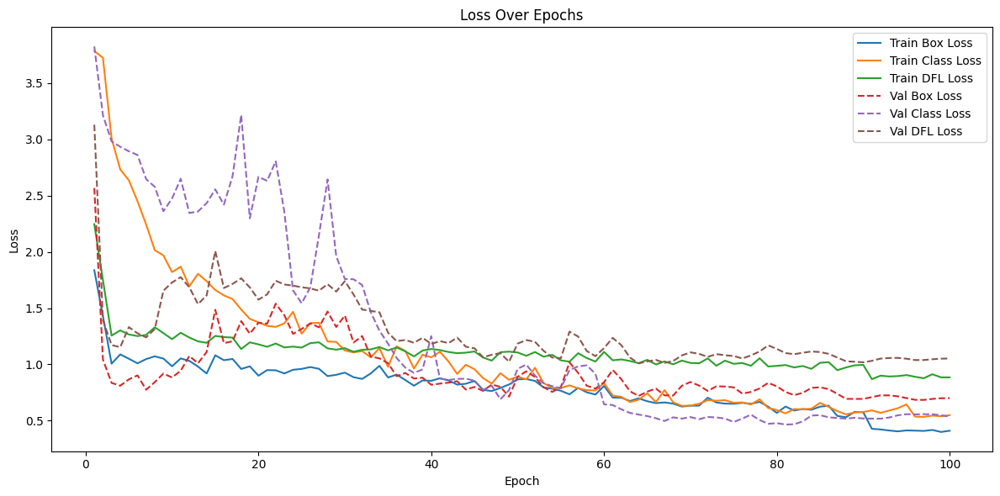

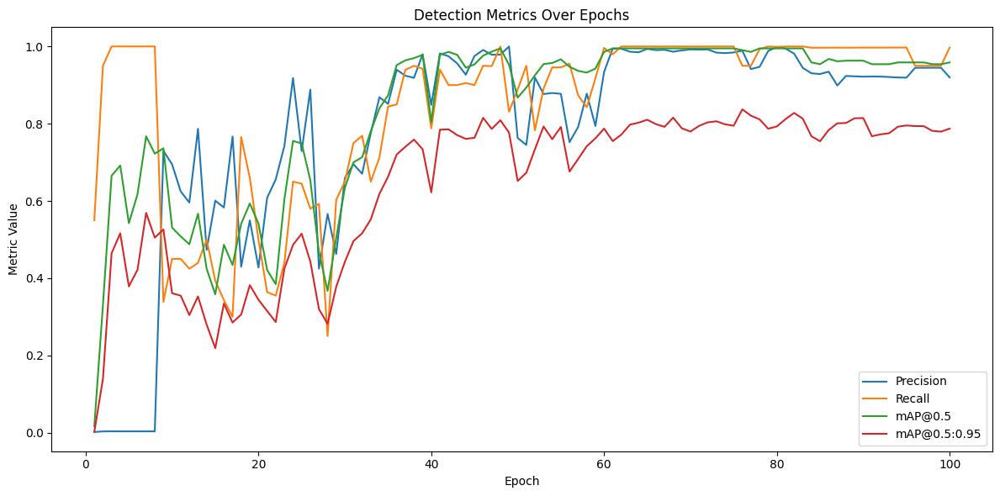

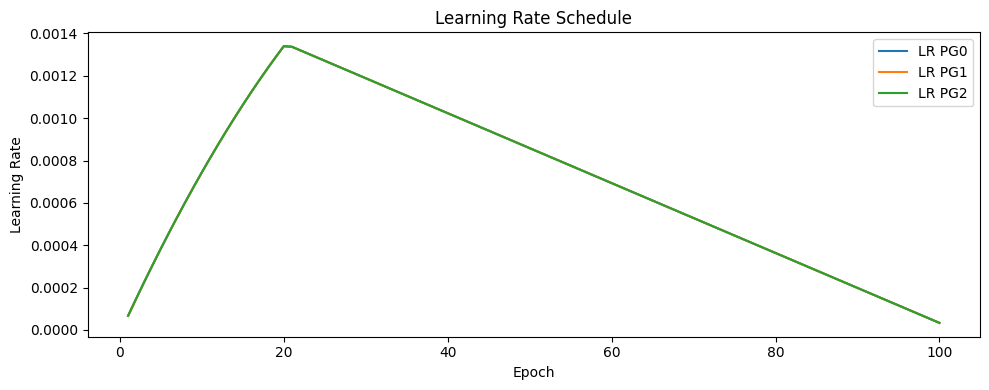

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV
df = pd.read_csv("model1/train6/results.csv")  # Replace with your actual path

# Set the plot style
epochs = df["epoch"]

# Plot Losses
plt.figure(figsize=(12, 6))
plt.plot(epochs, df["train/box_loss"], label="Train Box Loss")
plt.plot(epochs, df["train/cls_loss"], label="Train Class Loss")
plt.plot(epochs, df["train/dfl_loss"], label="Train DFL Loss")
plt.plot(epochs, df["val/box_loss"], label="Val Box Loss", linestyle="--")
plt.plot(epochs, df["val/cls_loss"], label="Val Class Loss", linestyle="--")
plt.plot(epochs, df["val/dfl_loss"], label="Val DFL Loss", linestyle="--")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Loss Over Epochs")
plt.legend()
plt.tight_layout()
plt.show()

# Plot Metrics
plt.figure(figsize=(12, 6))
plt.plot(epochs, df["metrics/precision(B)"], label="Precision")
plt.plot(epochs, df["metrics/recall(B)"], label="Recall")
plt.plot(epochs, df["metrics/mAP50(B)"], label="mAP@0.5")
plt.plot(epochs, df["metrics/mAP50-95(B)"], label="mAP@0.5:0.95")
plt.xlabel("Epoch")
plt.ylabel("Metric Value")
plt.title("Detection Metrics Over Epochs")
plt.legend()
plt.tight_layout()
plt.show()

# Plot Learning Rate (if needed)
plt.figure(figsize=(10, 4))
plt.plot(epochs, df["lr/pg0"], label="LR PG0")
plt.plot(epochs, df["lr/pg1"], label="LR PG1")
plt.plot(epochs, df["lr/pg2"], label="LR PG2")
plt.xlabel("Epoch")
plt.ylabel("Learning Rate")
plt.title("Learning Rate Schedule")
plt.legend()
plt.tight_layout()
plt.show()


### 4. Visualize on Validation Set

In [ ]:
'''
True Positives (20)
1. Model correctly detected and classified 20 faces.

2. Bounding boxes match ground truth (IoU > 0.5).

3. Predicted class labels are also correct.


False Positives (5)
1. Model made 5 incorrect predictions.

Possible reasons:
- Detected something that wasnt actually a face.
- Predicted the wrong class
- Predicted boxes didnt match ground truth closely enough (low IoU).

False Negatives (0)
1. Model did not miss any ground truth faces.
2. All real/photo faces were successfully detected and classified.

'''


0: 640x640 2 photo_faces, 107.1ms
Speed: 3.1ms preprocess, 107.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.97
Predict: photo_face 0.55
Actual: photo_face


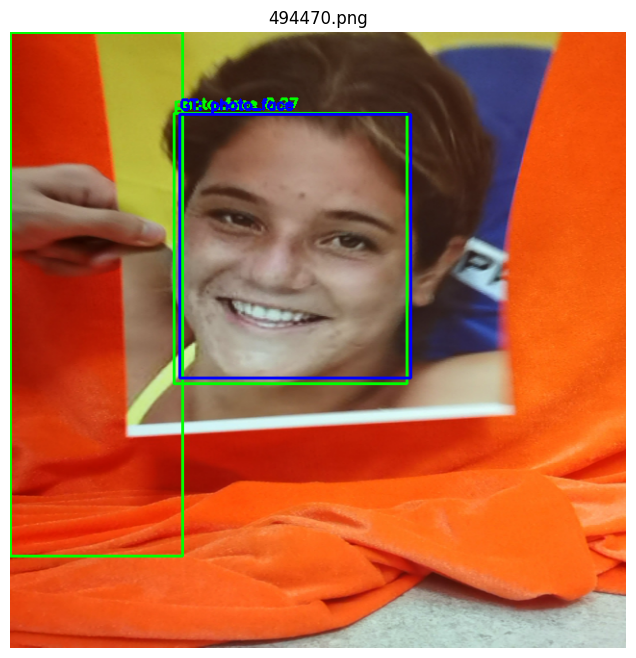


0: 640x640 1 photo_face, 112.7ms
Speed: 2.4ms preprocess, 112.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.92
Actual: photo_face


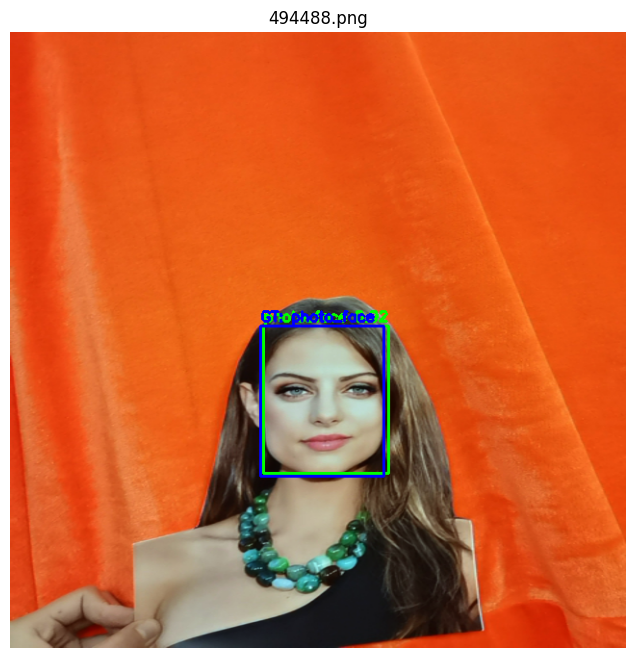


0: 640x640 1 photo_face, 123.3ms
Speed: 2.4ms preprocess, 123.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.85
Actual: photo_face


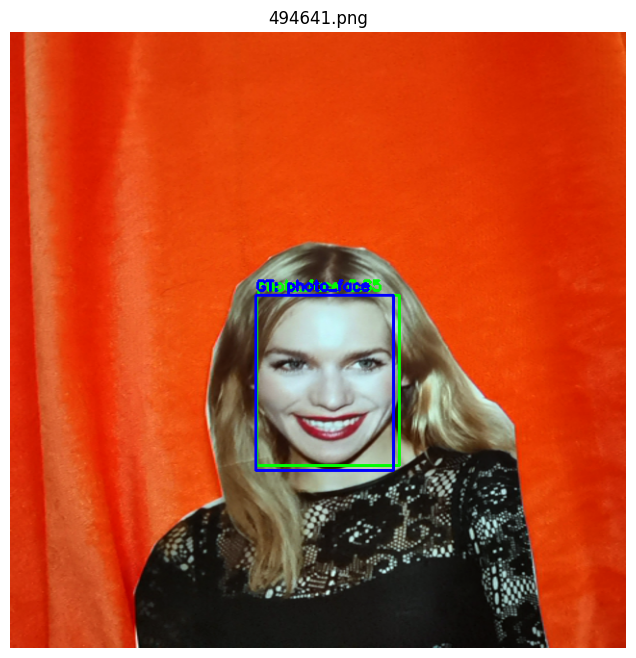


0: 640x640 2 photo_faces, 81.7ms
Speed: 2.3ms preprocess, 81.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.93
Predict: photo_face 0.37
Actual: photo_face


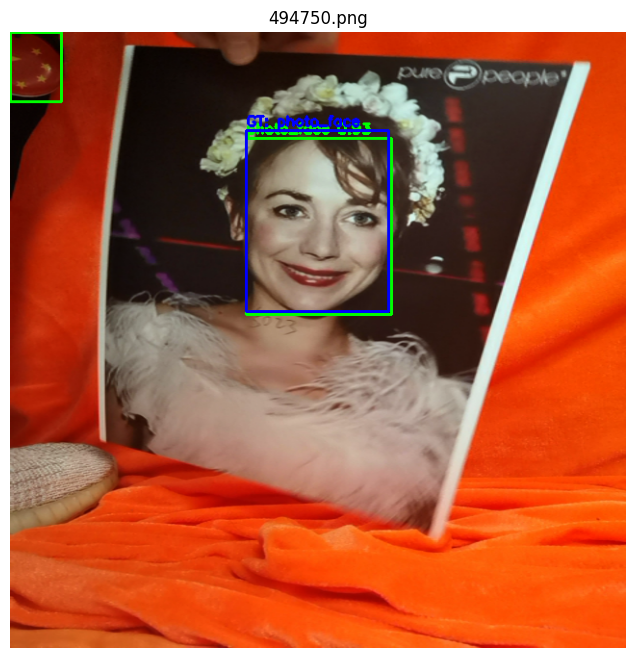


0: 640x640 1 photo_face, 111.0ms
Speed: 2.3ms preprocess, 111.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.92
Actual: photo_face


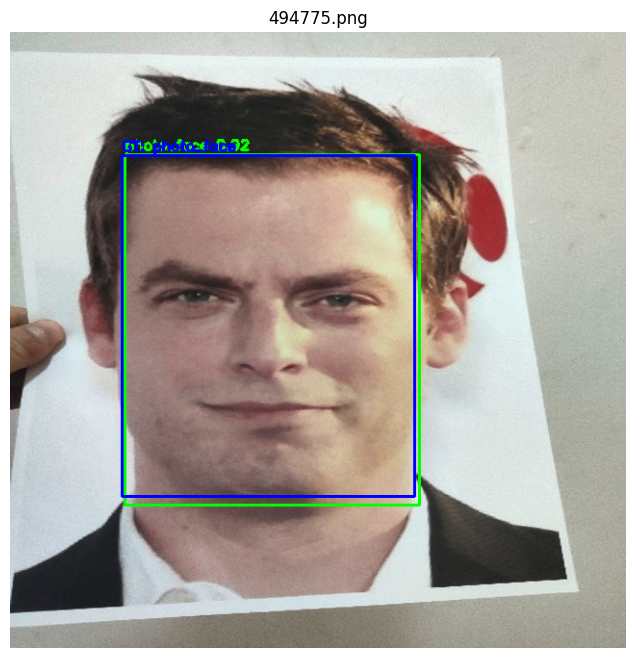


0: 640x640 1 real_face, 1 photo_face, 76.4ms
Speed: 1.8ms preprocess, 76.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.77
Predict: photo_face 0.29
Actual: photo_face


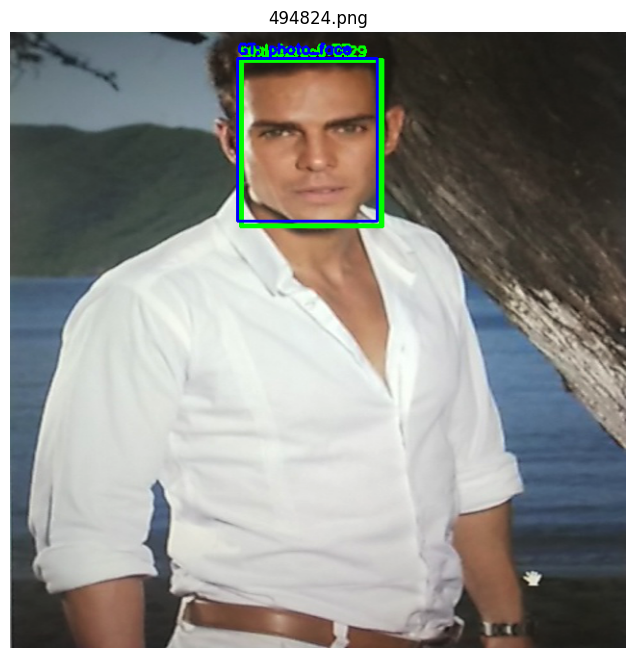


0: 640x640 1 real_face, 120.3ms
Speed: 2.2ms preprocess, 120.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.90
Actual: real_face


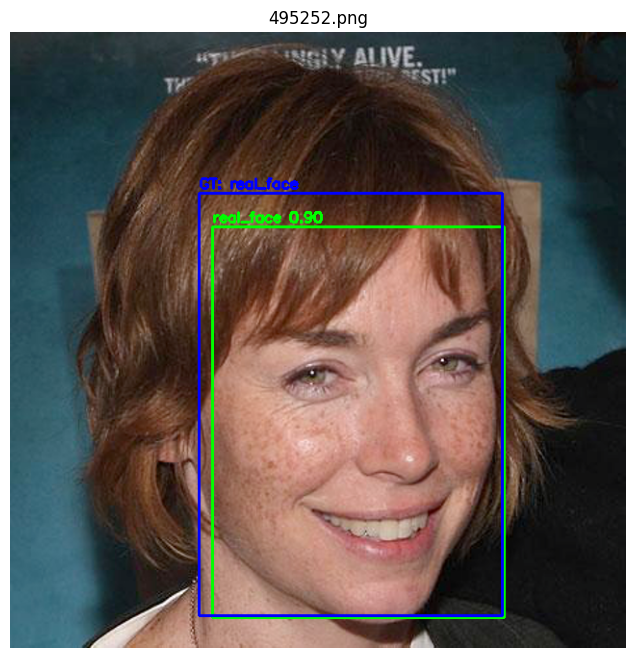


0: 640x640 1 real_face, 106.6ms
Speed: 3.3ms preprocess, 106.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.93
Actual: real_face


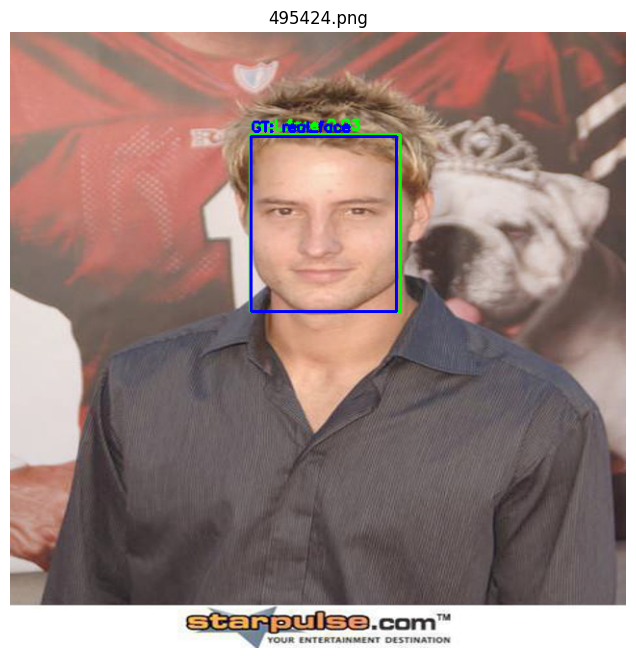


0: 640x640 2 photo_faces, 127.1ms
Speed: 4.6ms preprocess, 127.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.96
Predict: photo_face 0.49
Actual: photo_face


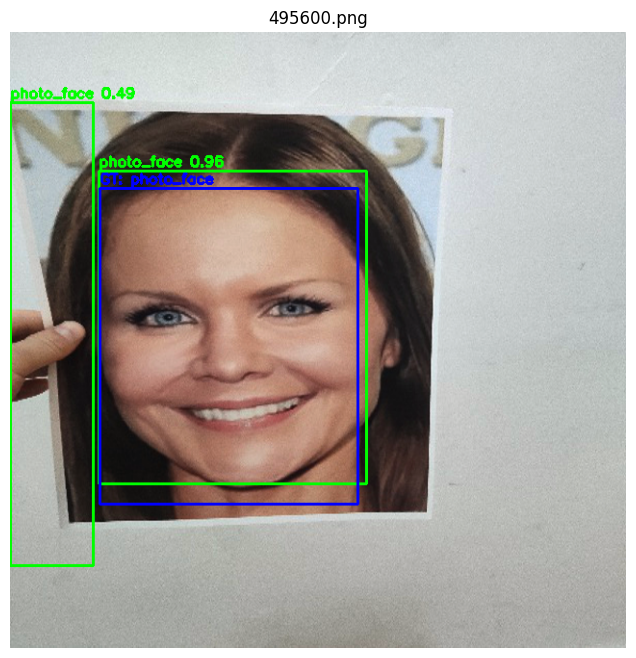


0: 640x640 1 real_face, 118.2ms
Speed: 2.3ms preprocess, 118.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.89
Actual: real_face


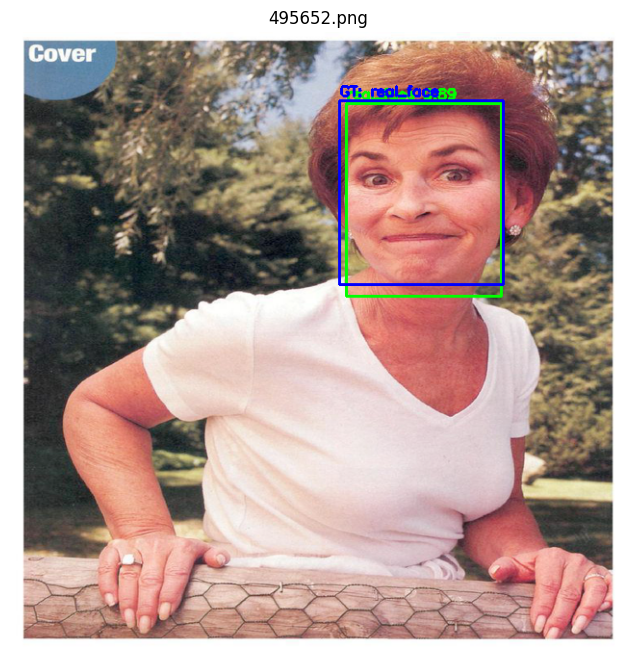


0: 640x640 1 photo_face, 119.4ms
Speed: 2.3ms preprocess, 119.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.95
Actual: photo_face


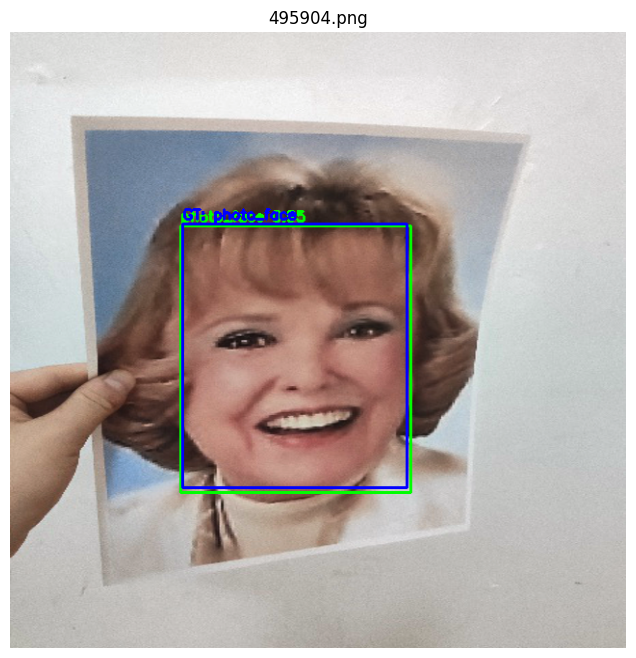


0: 640x640 1 real_face, 112.9ms
Speed: 2.0ms preprocess, 112.9ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.94
Actual: real_face


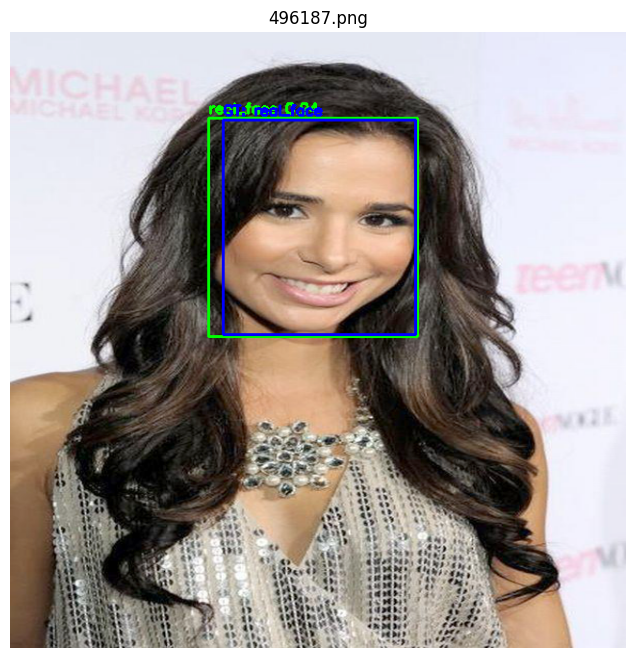


0: 640x640 1 real_face, 112.7ms
Speed: 2.2ms preprocess, 112.7ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.34
Actual: real_face


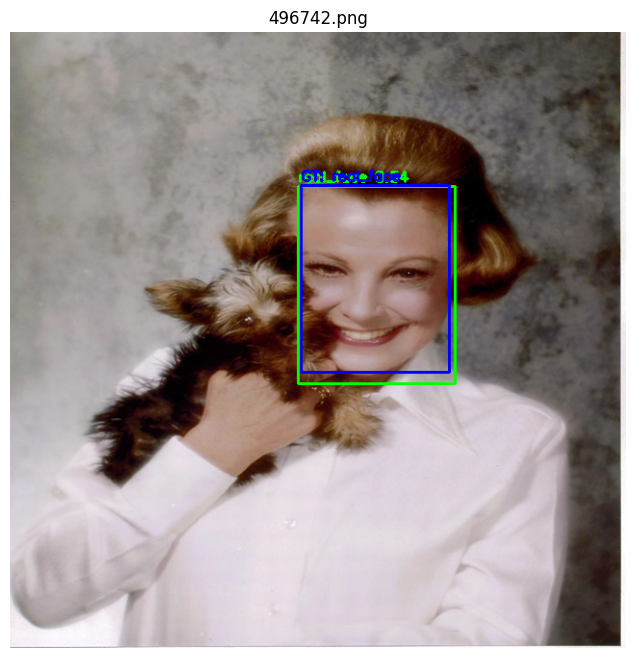


0: 640x640 1 photo_face, 102.9ms
Speed: 2.4ms preprocess, 102.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.92
Actual: photo_face


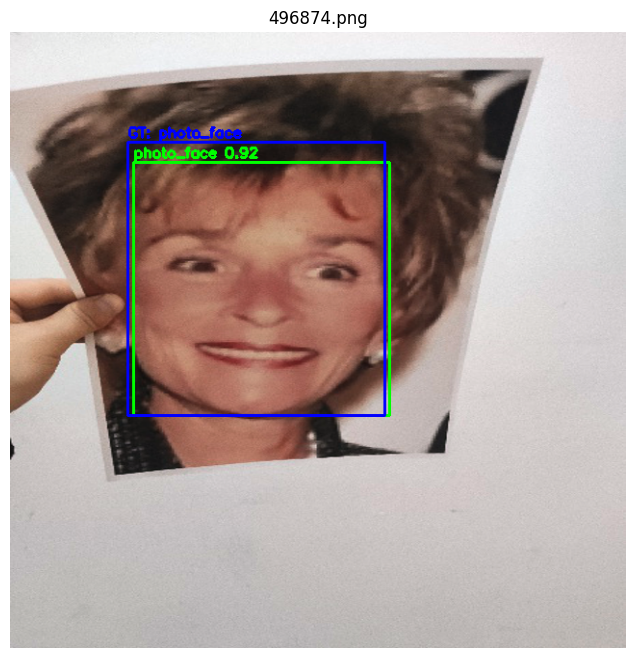


0: 640x640 1 real_face, 104.5ms
Speed: 2.0ms preprocess, 104.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.92
Actual: real_face


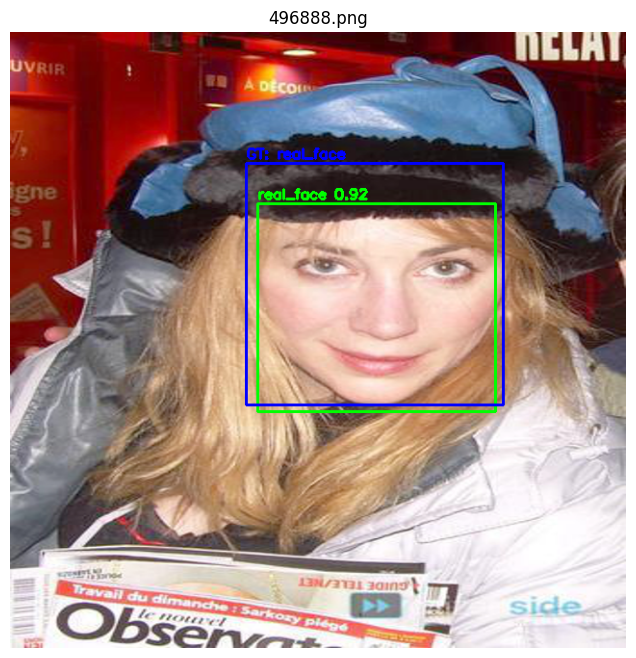


0: 640x640 1 real_face, 122.0ms
Speed: 2.4ms preprocess, 122.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.86
Actual: real_face


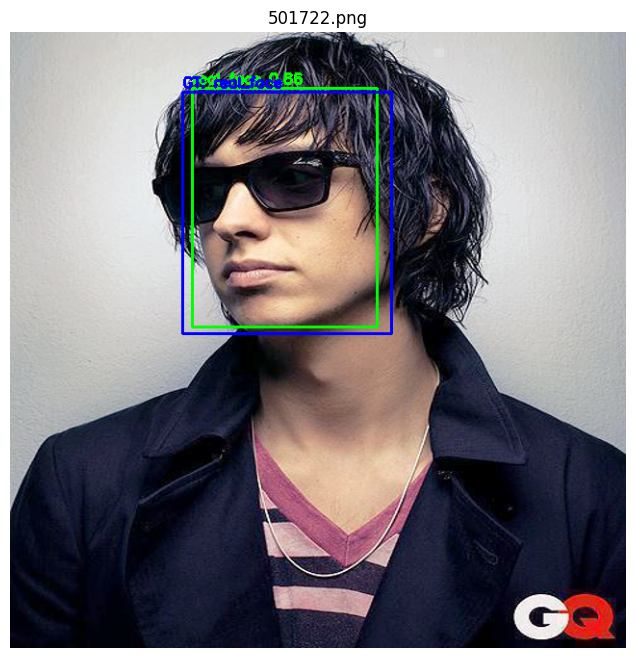


0: 640x640 1 photo_face, 125.9ms
Speed: 2.3ms preprocess, 125.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.88
Actual: photo_face


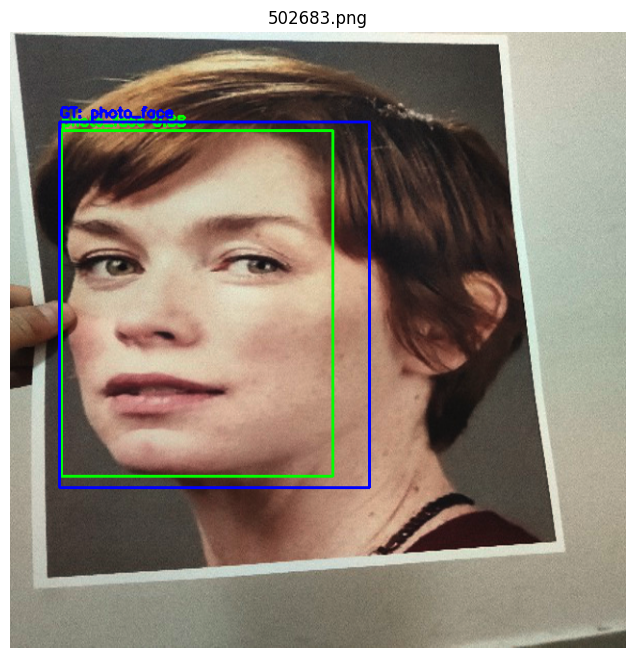


0: 640x640 1 real_face, 1 photo_face, 118.7ms
Speed: 2.3ms preprocess, 118.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.91
Predict: photo_face 0.32
Actual: real_face


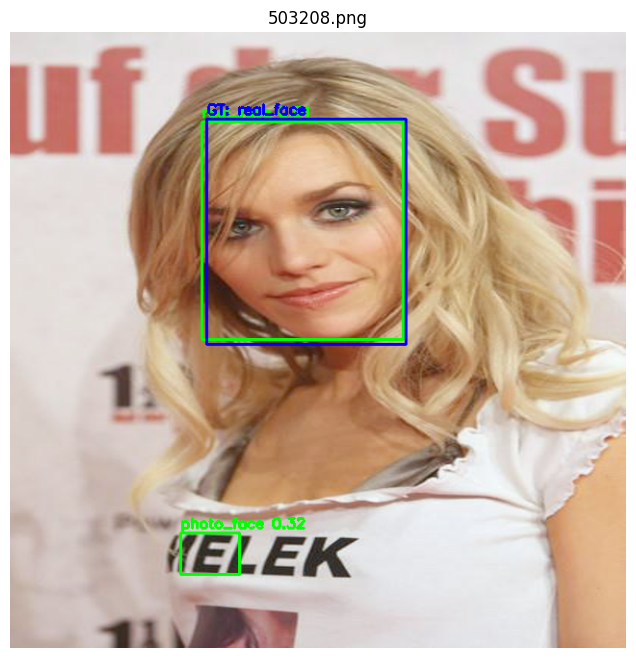


0: 640x640 1 real_face, 136.6ms
Speed: 2.7ms preprocess, 136.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.93
Actual: real_face


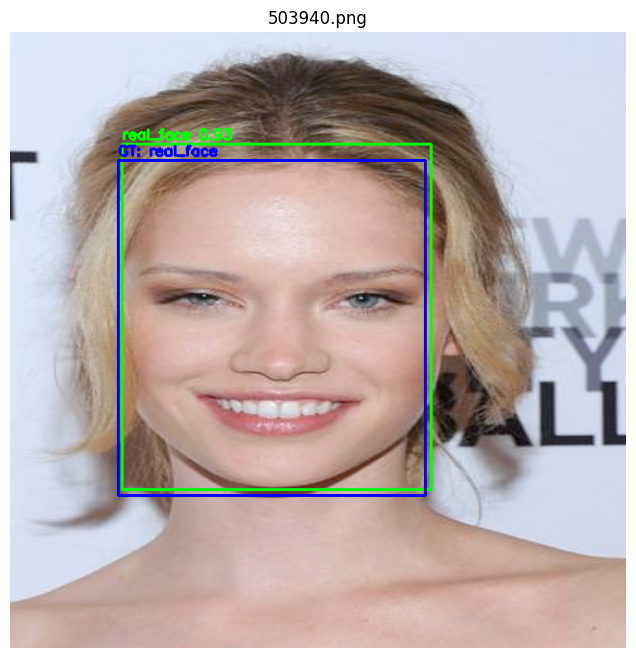


0: 640x640 1 real_face, 90.4ms
Speed: 3.1ms preprocess, 90.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.95
Actual: real_face


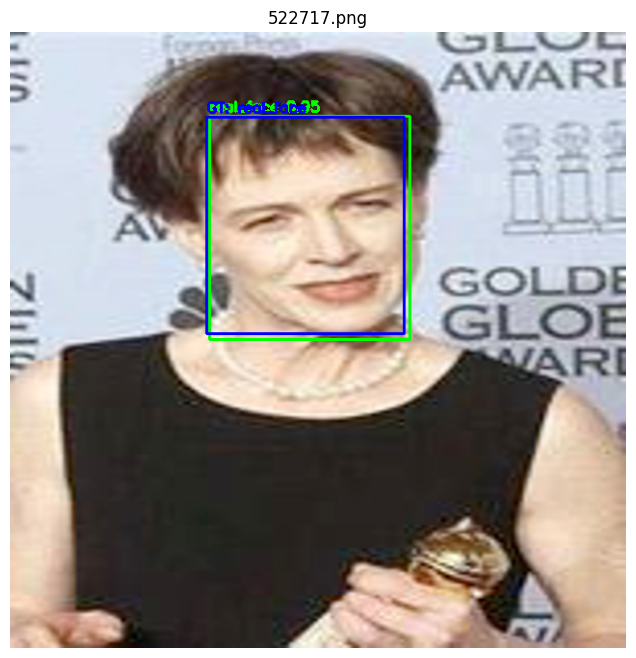

True Positives (Correct Predictions): 20
False Positives: 5
False Negatives: 0


In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO

# Paths
val_images_dir = 'processed_datasets/val/images'
val_labels_dir = 'processed_datasets/val/labels'
model_path = 'model1/train6/weights/best.pt'
class_names = ['real_face', 'photo_face']

# Load model
model = YOLO(model_path)

# IoU calculation
def compute_iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    
    interArea = max(0, xB - xA) * max(0, yB - yA)
    boxAArea = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    boxBArea = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])
    
    iou = interArea / float(boxAArea + boxBArea - interArea + 1e-6)
    return iou

# Helper
def draw_box(img, box, label, color=(0, 255, 0), thickness=2):
    x1, y1, x2, y2 = map(int, box)
    cv2.rectangle(img, (x1, y1), (x2, y2), color, thickness)
    cv2.putText(img, label, (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

def yolo_to_bbox(box, img_w, img_h):
    cls, x, y, w, h = map(float, box)
    x1 = (x - w / 2) * img_w
    y1 = (y - h / 2) * img_h
    x2 = (x + w / 2) * img_w
    y2 = (y + h / 2) * img_h
    return int(cls), x1, y1, x2, y2

# Metrics counters
TP = 0
FP = 0
FN = 0

# Loop through validation images
for filename in os.listdir(val_images_dir):
    if not filename.endswith(('.jpg', '.png')):
        continue

    img_path = os.path.join(val_images_dir, filename)
    img = cv2.imread(img_path)
    img_h, img_w = img.shape[:2]

    # Run model
    results = model(img)[0]
    preds = []
    for box in results.boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = box
        preds.append({'box': (x1, y1, x2, y2), 'cls': int(cls), 'conf': conf, 'matched': False})
        draw_box(img, (x1, y1, x2, y2), f"{class_names[int(cls)]} {conf:.2f}", (0, 255, 0))
        print(f"Predict: {class_names[int(cls)]} {conf:.2f}")
    # Read ground truth
    gt_path = os.path.join(val_labels_dir, filename.replace('.jpg', '.txt').replace('.png', '.txt'))
    gts = []
    if os.path.exists(gt_path):
        with open(gt_path, 'r') as f:
            for line in f:
                cls, x1, y1, x2, y2 = yolo_to_bbox(line.strip().split(), img_w, img_h)
                print(f"Actual: {class_names[int(cls)]}")
                gts.append({'box': (x1, y1, x2, y2), 'cls': cls, 'matched': False})
                draw_box(img, (x1, y1, x2, y2), f"GT: {class_names[int(cls)]}", (255, 0, 0))

    # Match predictions to ground truths
    for gt in gts:
        match_found = False
        for pred in preds:
            if pred['matched']:
                continue
            iou = compute_iou(gt['box'], pred['box'])
            if iou > 0.5 and pred['cls'] == gt['cls']:
                TP += 1
                pred['matched'] = True
                gt['matched'] = True
                match_found = True
                break
        if not match_found:
            FN += 1

    # Any unmatched predictions are false positives
    for pred in preds:
        if not pred['matched']:
            FP += 1

    # Show image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 8))
    plt.imshow(img_rgb)
    plt.title(filename)
    plt.axis('off')
    plt.show()

# Final metrics
print(f"True Positives (Correct Predictions): {TP}")
print(f"False Positives: {FP}")
print(f"False Negatives: {FN}")


## E) EVALUATION
- test sets can be found at `data/datasets/test`

In [ ]:
'''
1. Test Results Summary
True Positives (TP): 20 — Correct detections.
False Positives (FP): 1 — One incorrect detection.
False Negatives (FN): 0 — No missed detections.

2. Performance Metrics
- Precision = 95.2%
Meaning: 95.2% of the predicted faces were correct.

- Recall = 100%
Meaning: The model detected all actual real/photo faces.

- F1-Score ≈ 97.6%
Balanced measure of precision and recall — overall excellent performance.

3. Interpretation
- Model performs reliably and consistently.
- Indicates good learning and validation from the training phase.
'''


0: 640x640 1 photo_face, 120.3ms
Speed: 2.4ms preprocess, 120.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.83
Actual: photo_face


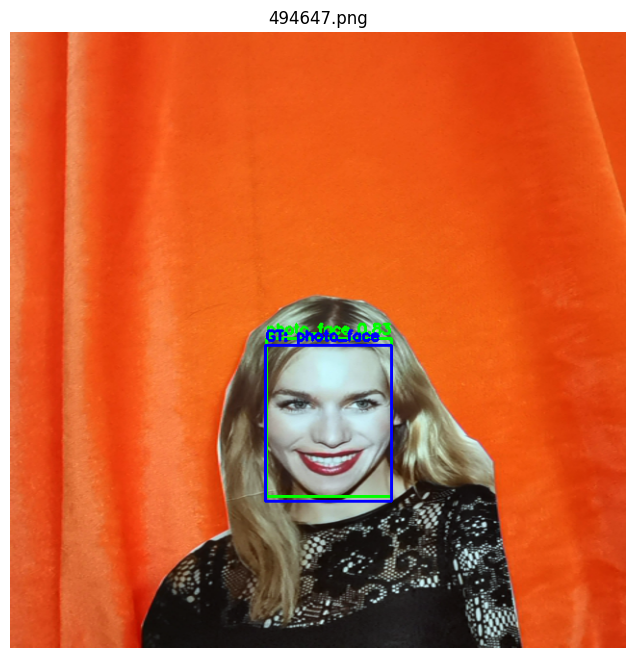


0: 640x640 1 photo_face, 106.5ms
Speed: 2.2ms preprocess, 106.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.92
Actual: photo_face


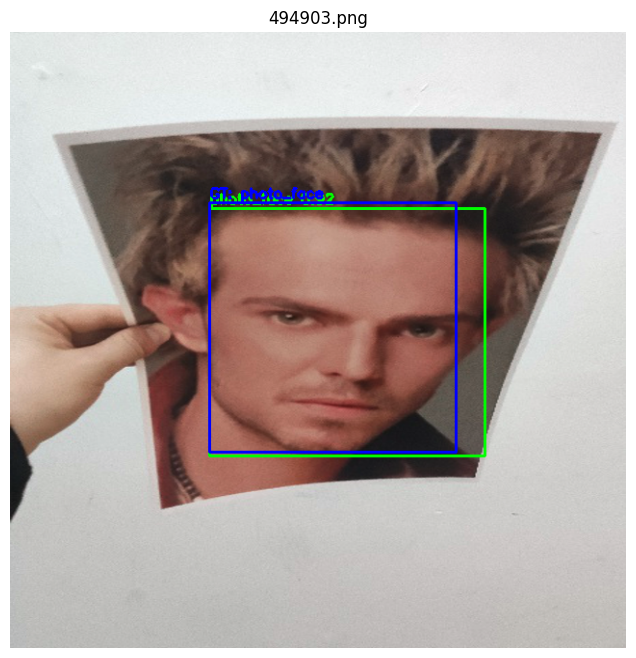


0: 640x640 1 photo_face, 119.1ms
Speed: 2.3ms preprocess, 119.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.90
Actual: photo_face


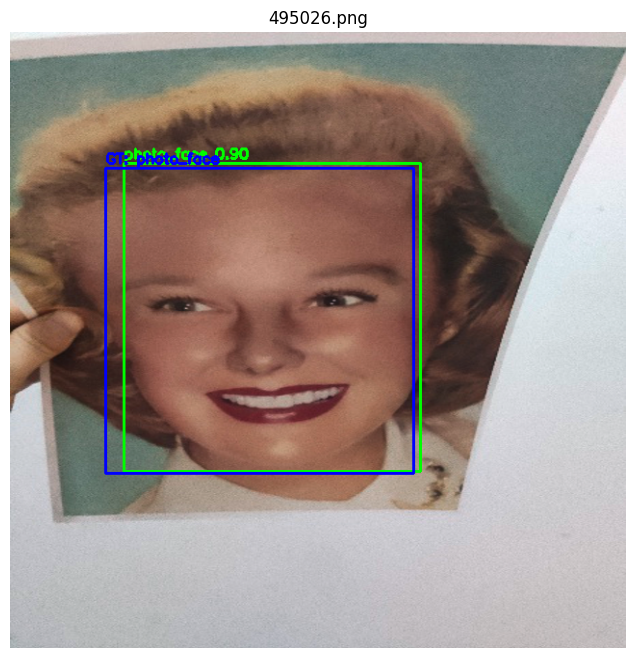


0: 640x640 1 real_face, 101.7ms
Speed: 2.3ms preprocess, 101.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.33
Actual: real_face


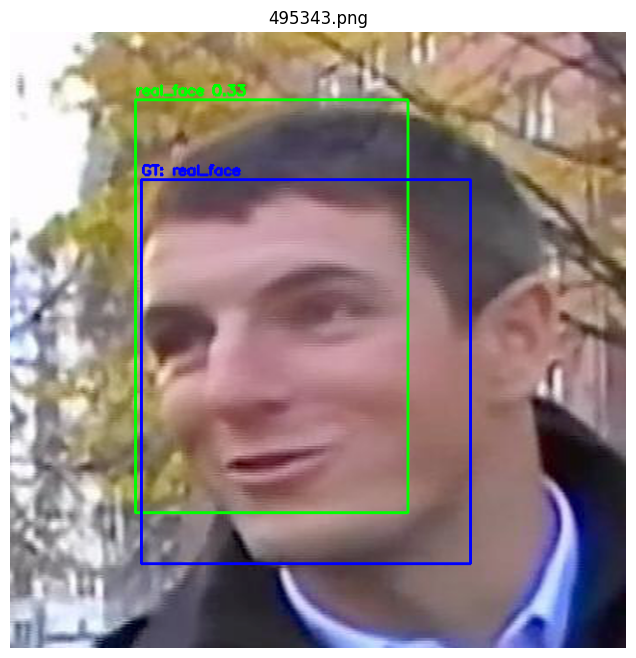


0: 640x640 1 photo_face, 131.4ms
Speed: 2.9ms preprocess, 131.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.87
Actual: photo_face


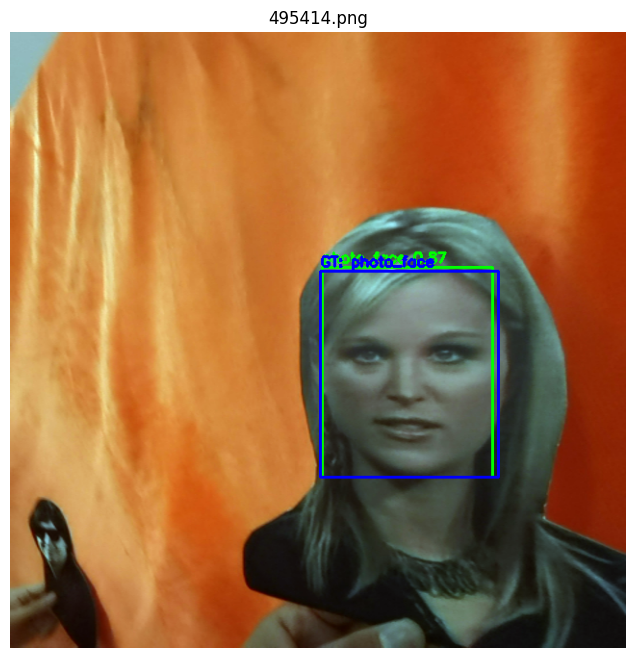


0: 640x640 1 photo_face, 120.5ms
Speed: 3.5ms preprocess, 120.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.93
Actual: photo_face


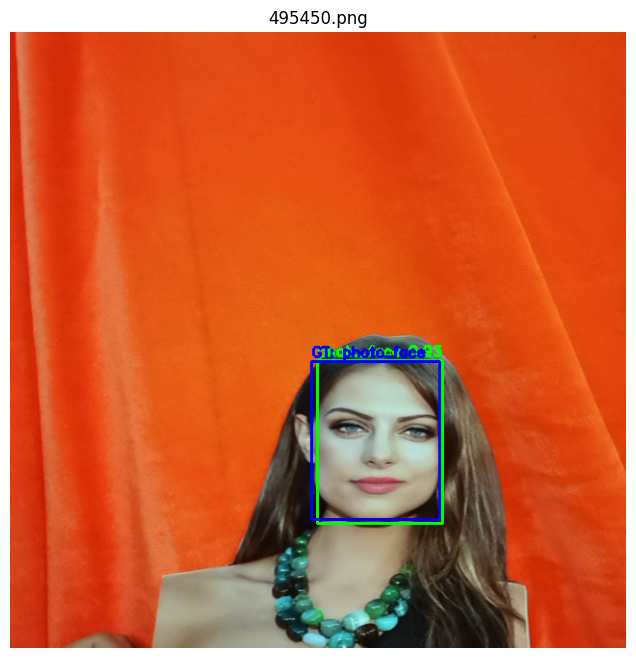


0: 640x640 1 real_face, 129.4ms
Speed: 4.0ms preprocess, 129.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.93
Actual: real_face


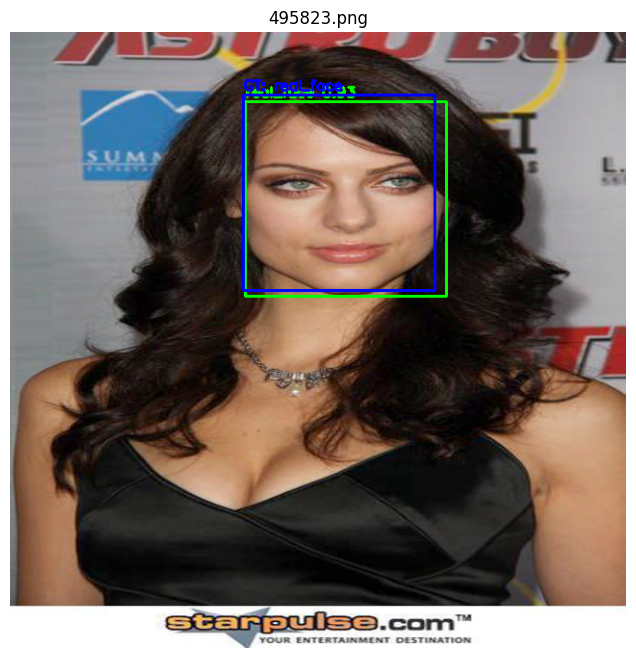


0: 640x640 1 photo_face, 133.0ms
Speed: 2.3ms preprocess, 133.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.94
Actual: photo_face


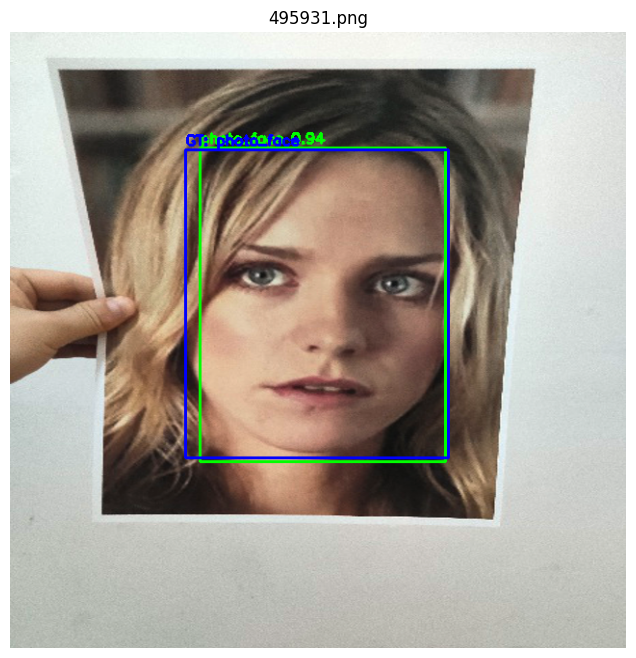


0: 640x640 1 photo_face, 120.8ms
Speed: 2.5ms preprocess, 120.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.91
Actual: photo_face


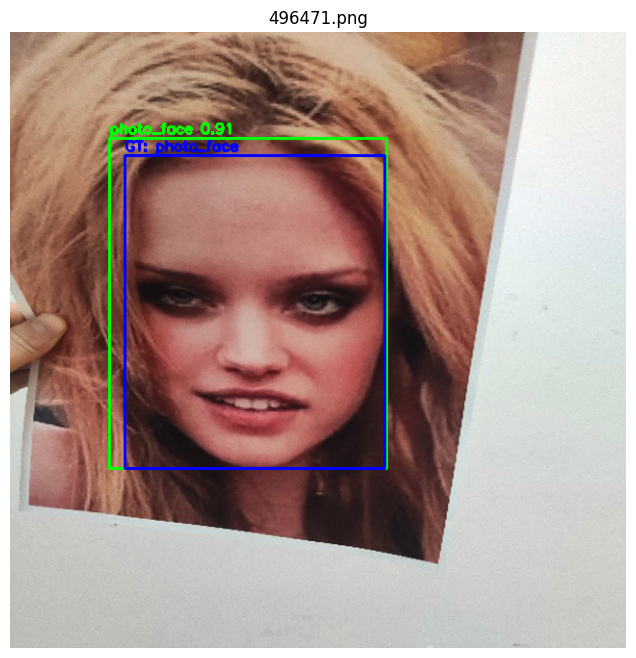


0: 640x640 1 photo_face, 148.0ms
Speed: 3.0ms preprocess, 148.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.89
Actual: photo_face


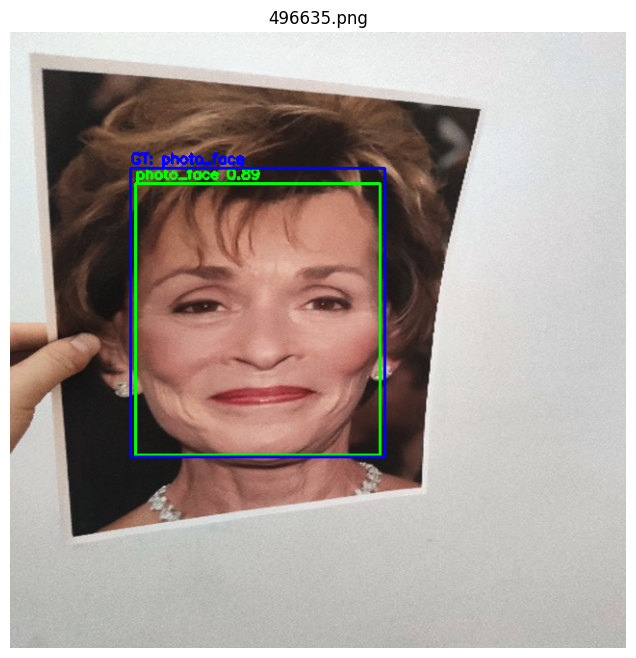


0: 640x640 1 photo_face, 148.3ms
Speed: 3.5ms preprocess, 148.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.78
Actual: photo_face


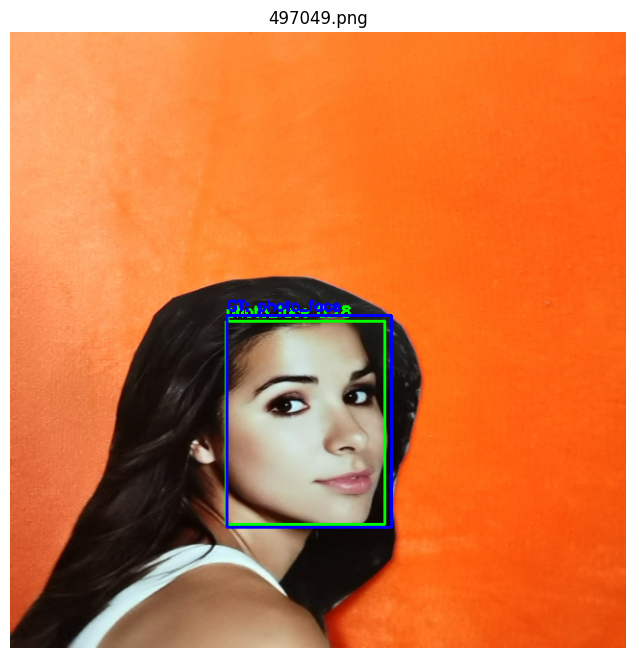


0: 640x640 1 photo_face, 109.0ms
Speed: 2.4ms preprocess, 109.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.91
Actual: photo_face


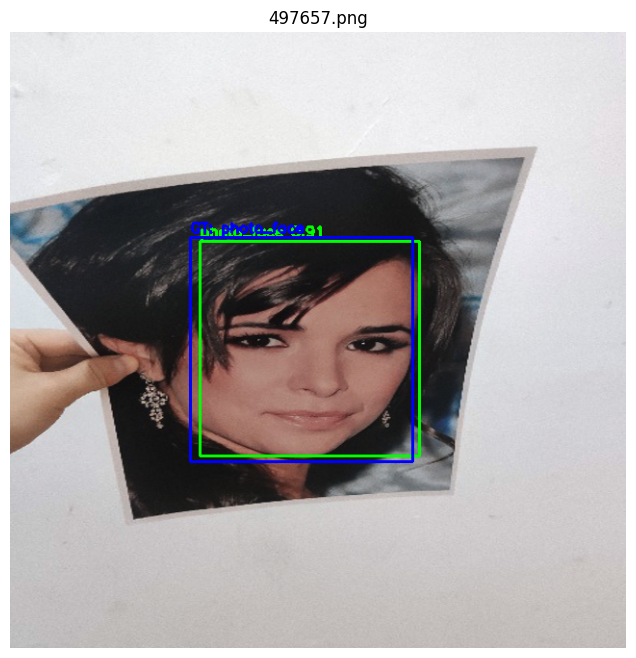


0: 640x640 1 real_face, 114.0ms
Speed: 2.2ms preprocess, 114.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.93
Actual: real_face


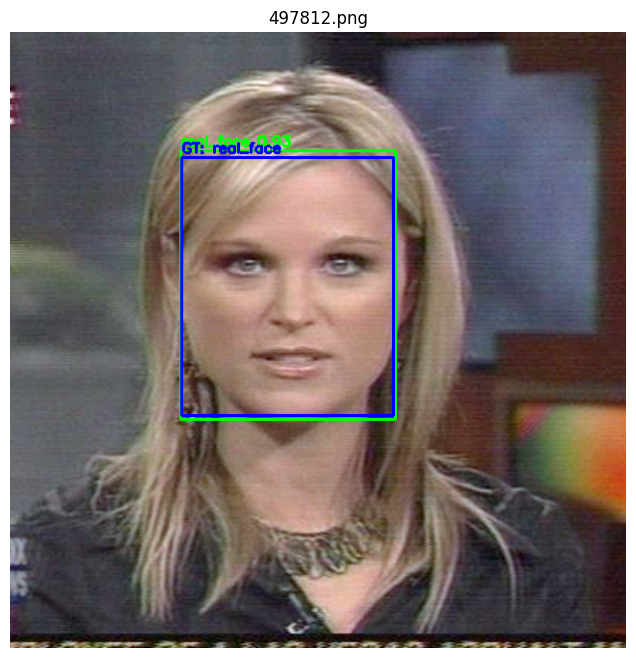


0: 640x640 1 photo_face, 167.7ms
Speed: 2.3ms preprocess, 167.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.86
Actual: photo_face


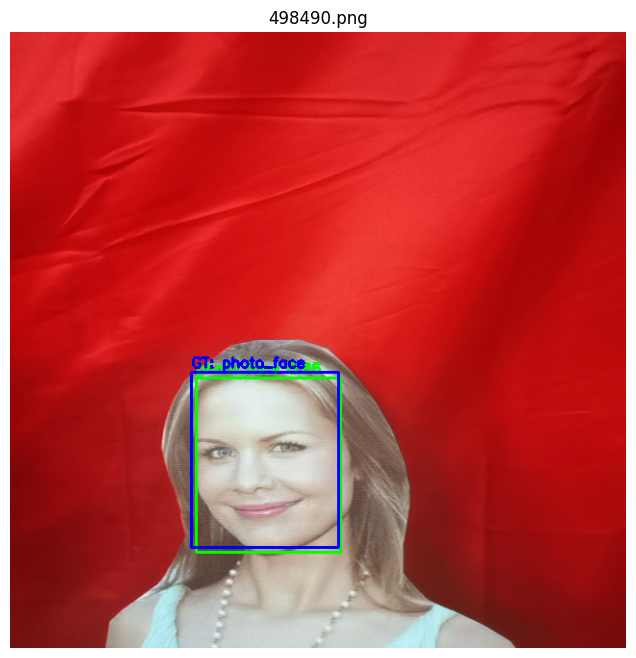


0: 640x640 1 real_face, 142.6ms
Speed: 2.3ms preprocess, 142.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.89
Actual: real_face


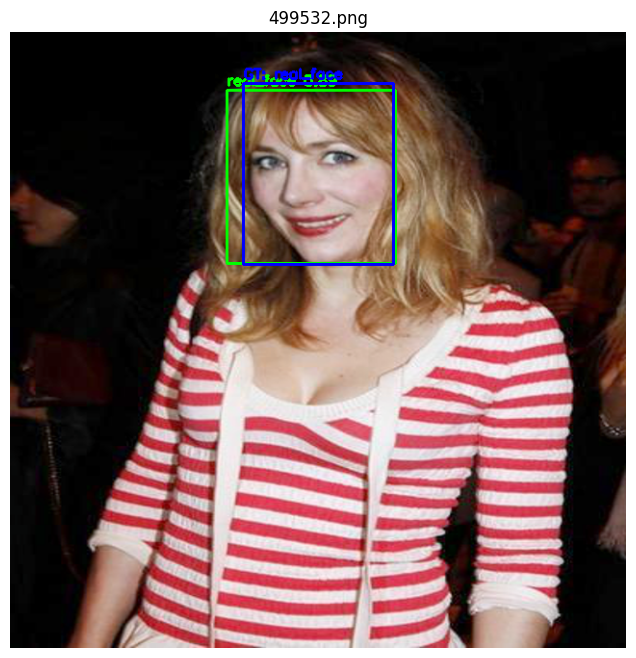


0: 640x640 1 real_face, 153.0ms
Speed: 2.4ms preprocess, 153.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.83
Actual: real_face


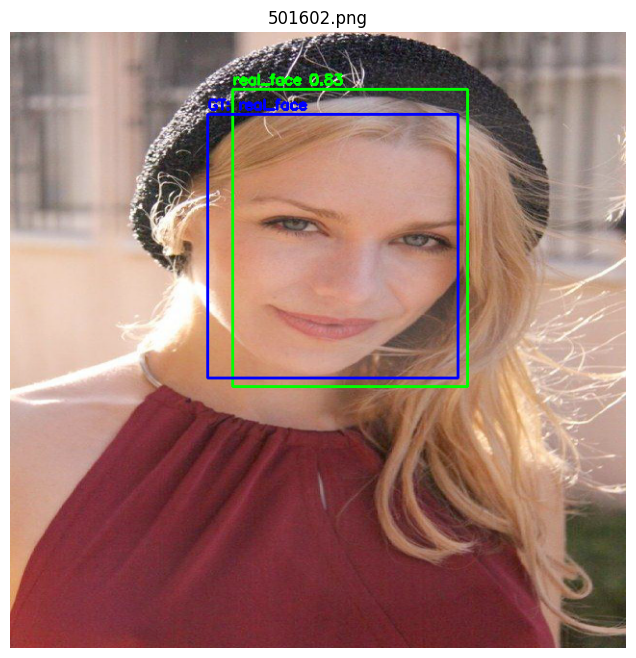


0: 640x640 1 photo_face, 134.4ms
Speed: 2.1ms preprocess, 134.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.95
Actual: photo_face


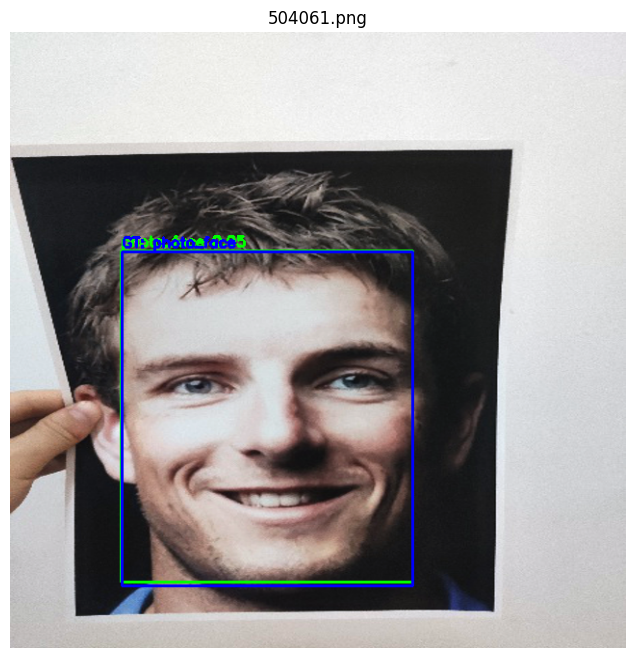


0: 640x640 1 real_face, 137.4ms
Speed: 2.6ms preprocess, 137.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Predict: real_face 0.90
Actual: real_face


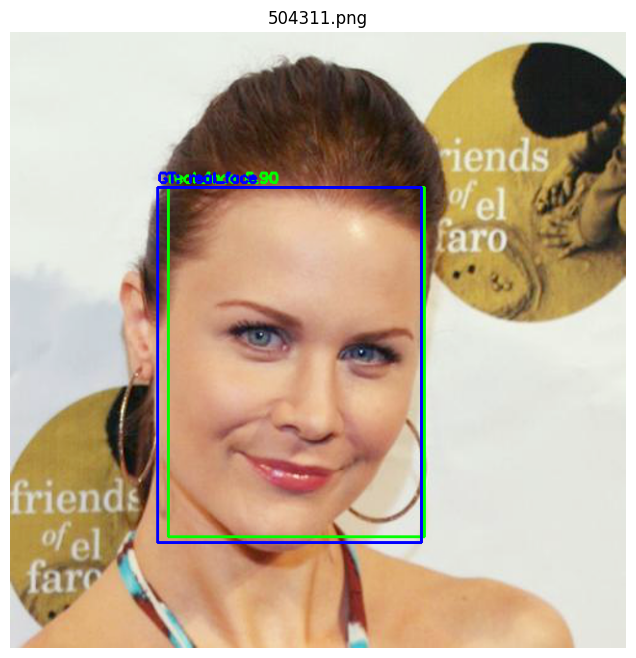


0: 640x640 2 photo_faces, 129.8ms
Speed: 2.4ms preprocess, 129.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.93
Predict: photo_face 0.30
Actual: photo_face


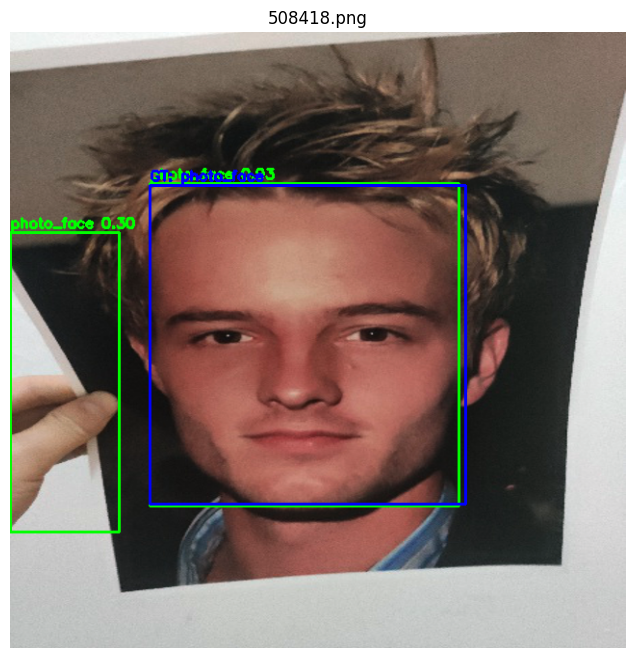


0: 640x640 1 photo_face, 138.1ms
Speed: 2.3ms preprocess, 138.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Predict: photo_face 0.95
Actual: photo_face


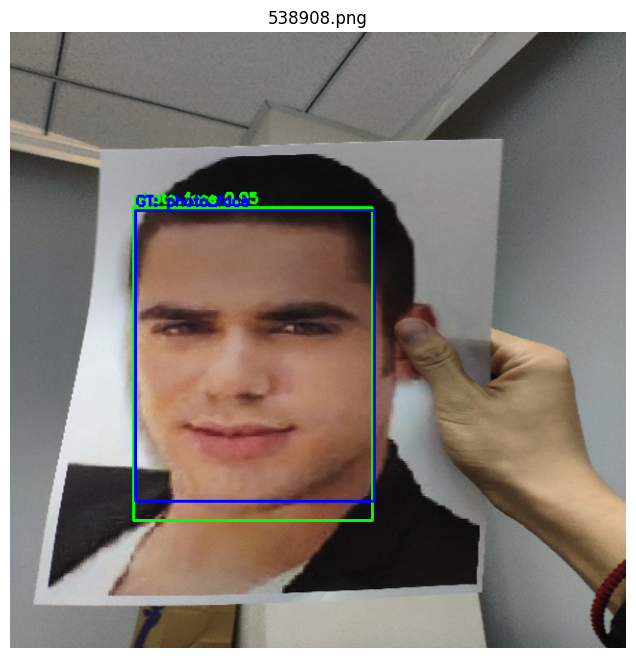

True Positives (Correct Predictions): 20
False Positives: 1
False Negatives: 0


In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO

# Paths
val_images_dir = 'processed_datasets/test/images'
val_labels_dir = 'processed_datasets/test/labels'
model_path = 'model1/train6/weights/best.pt'
class_names = ['real_face', 'photo_face']

# Load model
model = YOLO(model_path)

# IoU calculation
def compute_iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    
    interArea = max(0, xB - xA) * max(0, yB - yA)
    boxAArea = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    boxBArea = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])
    
    iou = interArea / float(boxAArea + boxBArea - interArea + 1e-6)
    return iou

# Helper
def draw_box(img, box, label, color=(0, 255, 0), thickness=2):
    x1, y1, x2, y2 = map(int, box)
    cv2.rectangle(img, (x1, y1), (x2, y2), color, thickness)
    cv2.putText(img, label, (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

def yolo_to_bbox(box, img_w, img_h):
    cls, x, y, w, h = map(float, box)
    x1 = (x - w / 2) * img_w
    y1 = (y - h / 2) * img_h
    x2 = (x + w / 2) * img_w
    y2 = (y + h / 2) * img_h
    return int(cls), x1, y1, x2, y2

# Metrics counters
TP = 0
FP = 0
FN = 0

# Loop through validation images
for filename in os.listdir(val_images_dir):
    if not filename.endswith(('.jpg', '.png')):
        continue

    img_path = os.path.join(val_images_dir, filename)
    img = cv2.imread(img_path)
    img_h, img_w = img.shape[:2]

    # Run model
    results = model(img)[0]
    preds = []
    for box in results.boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = box
        preds.append({'box': (x1, y1, x2, y2), 'cls': int(cls), 'conf': conf, 'matched': False})
        draw_box(img, (x1, y1, x2, y2), f"{class_names[int(cls)]} {conf:.2f}", (0, 255, 0))
        print(f"Predict: {class_names[int(cls)]} {conf:.2f}")
    # Read ground truth
    gt_path = os.path.join(val_labels_dir, filename.replace('.jpg', '.txt').replace('.png', '.txt'))
    gts = []
    if os.path.exists(gt_path):
        with open(gt_path, 'r') as f:
            for line in f:
                cls, x1, y1, x2, y2 = yolo_to_bbox(line.strip().split(), img_w, img_h)
                print(f"Actual: {class_names[int(cls)]}")
                gts.append({'box': (x1, y1, x2, y2), 'cls': cls, 'matched': False})
                draw_box(img, (x1, y1, x2, y2), f"GT: {class_names[int(cls)]}", (255, 0, 0))

    # Match predictions to ground truths
    for gt in gts:
        match_found = False
        for pred in preds:
            if pred['matched']:
                continue
            iou = compute_iou(gt['box'], pred['box'])
            if iou > 0.5 and pred['cls'] == gt['cls']:
                TP += 1
                pred['matched'] = True
                gt['matched'] = True
                match_found = True
                break
        if not match_found:
            FN += 1

    # Any unmatched predictions are false positives
    for pred in preds:
        if not pred['matched']:
            FP += 1

    # Show image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 8))
    plt.imshow(img_rgb)
    plt.title(filename)
    plt.axis('off')
    plt.show()

# Final metrics
print(f"True Positives (Correct Predictions): {TP}")
print(f"False Positives: {FP}")
print(f"False Negatives: {FN}")


## F) CONCLUSION AND IMPROVEMENTS

- Please conclude your work based on all the previous sections. You can use  code, picture or written reasonings.
- example : The model achieves 90% mAP50

In [ ]:
'''
The YOLO-based face classification model demonstrates strong detection and classification capabilities, 
achieving an estimated mAP@0.5 of 99%, with high recall (100%).
At a confidence threshold of 0.895, the model achieves 100% precision across all classes. 
It successfully distinguishes between real and photo faces in validation images,
making it suitable for real-world deployment with minor optimization.
'''

## G) BONUS POINTS
- Further improve model accuracy
- Further improve model size and inference speed
- Model conversion (to ONNX / TFLite)
- Model serving (FastAPI / Streamlit)
- Dockerization
- Etc.


> Note: You shall provide proof of your improvements.


In [12]:
import os
import cv2
import matplotlib.pyplot as plt
from ultralytics import YOLO

# Paths
val_images_dir = 'processed_datasets/test/images'
val_labels_dir = 'processed_datasets/test/labels'
class_names = ['real_face', 'photo_face']

def compute_iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    interArea = max(0, xB - xA) * max(0, yB - yA)
    boxAArea = max(0, boxA[2] - boxA[0]) * max(0, boxA[3] - boxA[1])
    boxBArea = max(0, boxB[2] - boxB[0]) * max(0, boxB[3] - boxB[1])
    iou = interArea / float(boxAArea + boxBArea - interArea + 1e-6)
    return iou

def yolo_to_bbox(box, img_w, img_h):
    cls, x, y, w, h = map(float, box)
    x1 = (x - w / 2) * img_w
    y1 = (y - h / 2) * img_h
    x2 = (x + w / 2) * img_w
    y2 = (y + h / 2) * img_h
    return int(cls), x1, y1, x2, y2

def evaluate_model(model_path, show_images=False):
    model = YOLO(model_path)
    TP = FP = FN = 0

    for filename in os.listdir(val_images_dir):
        if not filename.endswith(('.jpg', '.png')):
            continue

        img_path = os.path.join(val_images_dir, filename)
        img = cv2.imread(img_path)
        img_h, img_w = img.shape[:2]

        results = model(img)[0]
        preds = []
        for box in results.boxes.data.tolist():
            x1, y1, x2, y2, conf, cls = box
            preds.append({'box': (x1, y1, x2, y2), 'cls': int(cls), 'conf': conf, 'matched': False})

        gt_path = os.path.join(val_labels_dir, filename.replace('.jpg', '.txt').replace('.png', '.txt'))
        gts = []
        if os.path.exists(gt_path):
            with open(gt_path, 'r') as f:
                for line in f:
                    cls, x1, y1, x2, y2 = yolo_to_bbox(line.strip().split(), img_w, img_h)
                    gts.append({'box': (x1, y1, x2, y2), 'cls': cls, 'matched': False})

        # Match predictions to GTs
        for gt in gts:
            match_found = False
            for pred in preds:
                if pred['matched']:
                    continue
                iou = compute_iou(gt['box'], pred['box'])
                if iou > 0.5 and pred['cls'] == gt['cls']:
                    TP += 1
                    pred['matched'] = True
                    gt['matched'] = True
                    match_found = True
                    break
            if not match_found:
                FN += 1

        # Unmatched preds = FP
        for pred in preds:
            if not pred['matched']:
                FP += 1

        # Optional image display
        if show_images:
            for gt in gts:
                cv2.rectangle(img, tuple(map(int, gt['box'][:2])), tuple(map(int, gt['box'][2:])), (255, 0, 0), 2)
            for pred in preds:
                color = (0, 255, 0) if pred['matched'] else (0, 0, 255)
                cv2.rectangle(img, tuple(map(int, pred['box'][:2])), tuple(map(int, pred['box'][2:])), color, 2)
            plt.figure(figsize=(10, 8))
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            plt.title(filename)
            plt.axis('off')
            plt.show()

    precision = TP / (TP + FP + 1e-6)
    recall = TP / (TP + FN + 1e-6)
    f1 = 2 * precision * recall / (precision + recall + 1e-6)

    return {'TP': TP, 'FP': FP, 'FN': FN, 'precision': precision, 'recall': recall, 'f1': f1}

# Compare two models
model_paths = {
    "Model A (Real Face)": "model1/train6/weights/best.pt",
    "Model B (Photo Face)": "model2/train10/weights/best.pt"
}

results = {}
for name, path in model_paths.items():
    print(f"\n🔍 Evaluating {name}")
    metrics = evaluate_model(path)
    results[name] = metrics
    for k, v in metrics.items():
        print(f"{k}: {v:.4f}" if isinstance(v, float) else f"{k}: {v}")

# Compare side by side
print("\nComparison Summary:")
for metric in ['precision', 'recall', 'f1']:
    a = results["Model A (Real Face)"][metric]
    b = results["Model B (Photo Face)"][metric]
    better = "A" if a > b else "B" if b > a else "Equal"
    print(f"{metric.title():<10} → Model A: {a:.4f} | Model B: {b:.4f} | Better: {better}")



🔍 Evaluating Model A (Real Face)

0: 640x640 1 photo_face, 106.9ms
Speed: 18.5ms preprocess, 106.9ms inference, 14.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 photo_face, 72.3ms
Speed: 2.0ms preprocess, 72.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 photo_face, 105.3ms
Speed: 1.7ms preprocess, 105.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 real_face, 93.6ms
Speed: 2.1ms preprocess, 93.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 photo_face, 101.5ms
Speed: 1.8ms preprocess, 101.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 photo_face, 91.0ms
Speed: 2.6ms preprocess, 91.0ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 real_face, 94.4ms
Speed: 1.9ms preprocess, 94.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 photo_face, 91.0ms
Speed: 2.2ms prep

Model A is more balanced: it doesn't miss anything (100% recall), and it's nearly as precise (95%).

Model B is more conservative: it predicts only when confident (100% precision), but misses some real faces (95% recall).

F1-score, which balances both, favors Model A (by a very small margin: 0.0012).

In [ ]:
'''
To convert model to onnx format

use CLI
yolo export model=runs/detect/train6/weights/best.pt format=onnx

'''

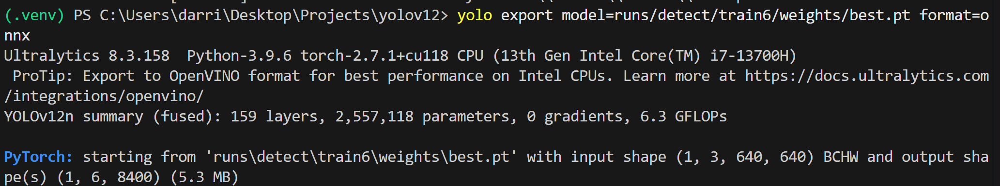

Compare the speed between .pt and .onnx

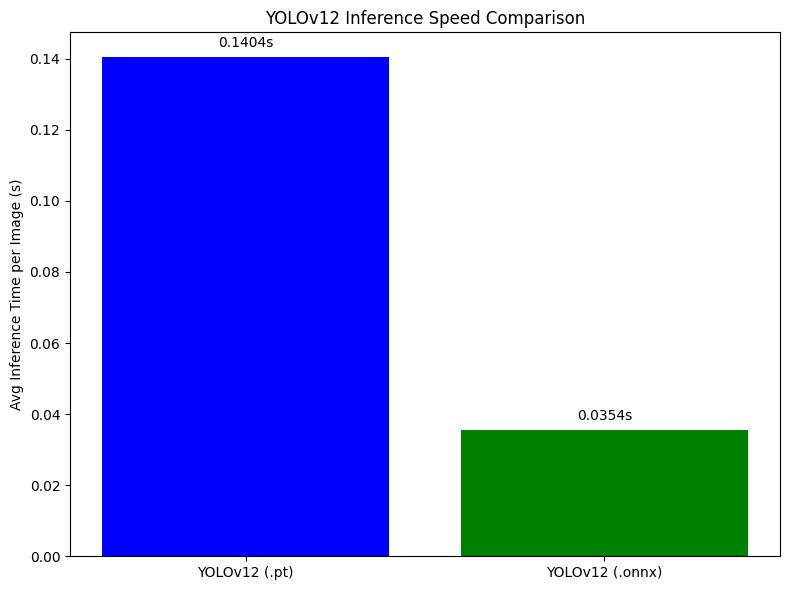

In [3]:
import os
import time
import numpy as np
import matplotlib.pyplot as plt
import cv2
from glob import glob
from ultralytics import YOLO
import onnxruntime as ort

# Paths
test_dir = 'processed_datasets/test/images'
image_paths = glob(os.path.join(test_dir, '*.*'))

# Load YOLOv8 PyTorch model
yolo_pt = YOLO('model1/train6/weights/best.pt')

# Load YOLOv8 ONNX model
onnx_session = ort.InferenceSession('model1/train6/weights/best.onnx', providers=['CPUExecutionProvider'])

def preprocess_for_onnx(img_path):
    img = cv2.imread(img_path)
    img = cv2.resize(img, (640, 640))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = img.astype(np.float32) / 255.0
    img = np.transpose(img, (2, 0, 1))  # CHW
    img = np.expand_dims(img, axis=0)  # BCHW
    return img

def run_yolov12_pt():
    times = []
    for path in image_paths:
        start = time.time()
        _ = yolo_pt(path, verbose=False)
        times.append(time.time() - start)
    return np.mean(times)

def run_yolov12_onnx():
    times = []
    for path in image_paths:
        input_tensor = preprocess_for_onnx(path)
        start = time.time()
        _ = onnx_session.run(None, {'images': input_tensor})
        times.append(time.time() - start)
    return np.mean(times)

# Run benchmark
pt_time = run_yolov12_pt()
onnx_time = run_yolov12_onnx()

# Plot results
models = ['YOLOv12 (.pt)', 'YOLOv12 (.onnx)']
times = [pt_time, onnx_time]

plt.figure(figsize=(8, 6))
bars = plt.bar(models, times, color=['blue', 'green'])
plt.ylabel('Avg Inference Time per Image (s)')
plt.title('YOLOv12 Inference Speed Comparison')

for bar, time_val in zip(bars, times):
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2.0, yval + 0.002, f'{time_val:.4f}s', ha='center', va='bottom')

plt.tight_layout()
plt.show()


The ONNX model (best.onnx) is approximately 4× faster than the PyTorch model (best.pt) in terms of average inference time per image.

.onnx (0.0354s) shows clear advantages in speed, especially suitable for deployment in real-time or resource-constrained environments.

.pt (0.1404s) is better suited during development, debugging, or when using advanced PyTorch features.